In [2]:
! pip install pandas
! pip install numpy
! pip install matplotlib
! pip install scikit-learn


[notice] A new release of pip is available: 24.2 -> 25.0
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 24.2 -> 25.0
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 24.2 -> 25.0
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 24.2 -> 25.0
[notice] To update, run: pip install --upgrade pip


In [3]:
from sklearn.datasets import load_breast_cancer
import pandas as pd

# Load dataset
data = load_breast_cancer()
df = pd.DataFrame(data.data, columns=data.feature_names)
df['target'] = data.target  # 1 = Malignant, 0 = Benign

# Save to CSV for local use
df.to_csv("breast_cancer.csv", index=False)

# Preview data
print(df.head())

   mean radius  mean texture  mean perimeter  mean area  mean smoothness  \
0        17.99         10.38          122.80     1001.0          0.11840   
1        20.57         17.77          132.90     1326.0          0.08474   
2        19.69         21.25          130.00     1203.0          0.10960   
3        11.42         20.38           77.58      386.1          0.14250   
4        20.29         14.34          135.10     1297.0          0.10030   

   mean compactness  mean concavity  mean concave points  mean symmetry  \
0           0.27760          0.3001              0.14710         0.2419   
1           0.07864          0.0869              0.07017         0.1812   
2           0.15990          0.1974              0.12790         0.2069   
3           0.28390          0.2414              0.10520         0.2597   
4           0.13280          0.1980              0.10430         0.1809   

   mean fractal dimension  ...  worst texture  worst perimeter  worst area  \
0             

In [4]:
df.describe()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,0.627417
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,0.483918
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,0.000000
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,0.000000
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,1.000000
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,1.000000
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,1.000000


In [5]:
# now doing some EDA
import matplotlib.pyplot as plt
import seaborn
seaborn.pairplot(df, hue='target')

In [7]:
# selecting features

X = df.drop('target', axis=1)
y = df['target']
X.shape, y.shape 

((569, 30), (569,))

In [8]:
# detecting missing values
df.isnull().sum()

mean radius                0
mean texture               0
mean perimeter             0
mean area                  0
mean smoothness            0
mean compactness           0
mean concavity             0
mean concave points        0
mean symmetry              0
mean fractal dimension     0
radius error               0
texture error              0
perimeter error            0
area error                 0
smoothness error           0
compactness error          0
concavity error            0
concave points error       0
symmetry error             0
fractal dimension error    0
worst radius               0
worst texture              0
worst perimeter            0
worst area                 0
worst smoothness           0
worst compactness          0
worst concavity            0
worst concave points       0
worst symmetry             0
worst fractal dimension    0
target                     0
dtype: int64

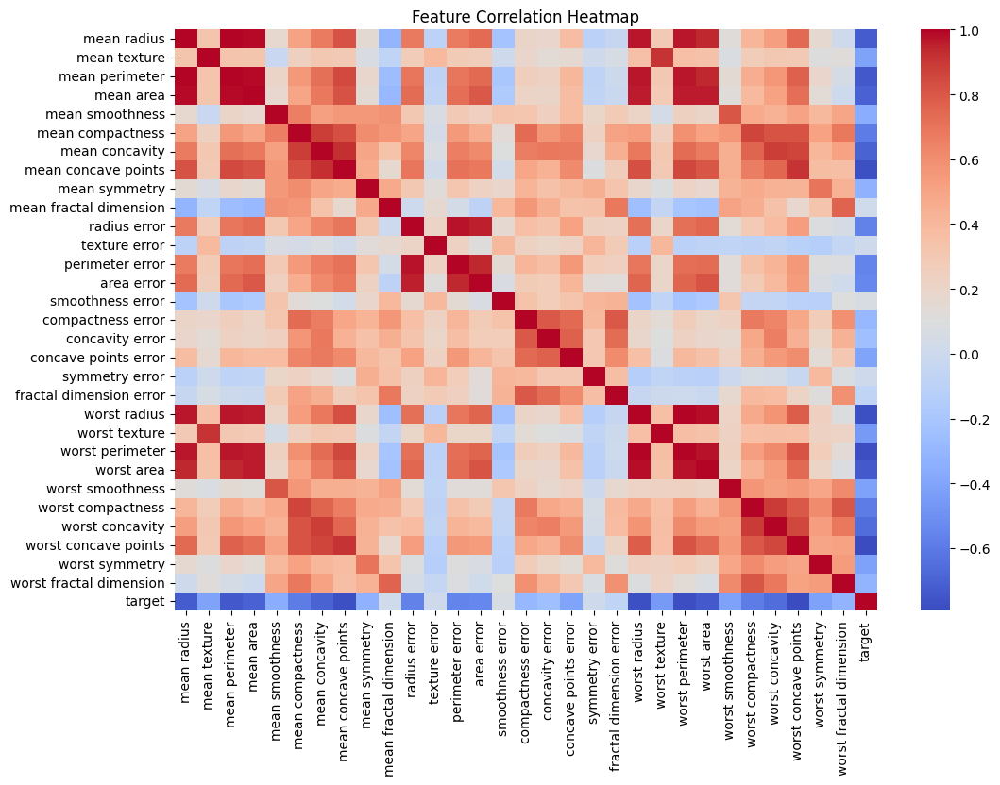

In [15]:
import seaborn as sns 

correlation_matrix = df.corr()

# Visualize correlation heatmap
plt.figure(figsize=(12,8))
sns.heatmap(correlation_matrix, annot=False, cmap="coolwarm")
plt.title("Feature Correlation Heatmap")
plt.show()


In [17]:
from sklearn.feature_selection import VarianceThreshold

# Set a variance threshold (e.g., remove features with variance < 0.01)
selector = VarianceThreshold(threshold=0.01)
selected_features = selector.fit_transform(df.drop(columns=['target']))

# Print selected feature names
selected_feature_names = df.drop(columns=['target']).columns[selector.get_support()]
print("Selected Features:", selected_feature_names)
selected_feature_names.shape


Selected Features: Index(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'worst radius', 'worst texture', 'worst perimeter', 'worst area',
       'worst compactness', 'worst concavity'],
      dtype='object')


(14,)

In [25]:
# Split data into training and test sets
from sklearn.model_selection import train_test_split

X = df[selected_feature_names] # using selected features

# scale data for numerical stability
from sklearn.preprocessing import StandardScaler
X = StandardScaler().fit_transform(X)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)



In [26]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((512, 14), (57, 14), (512,), (57,))

## Logistic regression

Logistic regression is an extension of linear regression with a non-linear activation function.

#### 1. Regression formula

<div align="center">

$p(x) = \frac{1}{1 + e^{-z}}$

where:

$z = w \cdot x + b$
</div>


#### 2. Loss Function (Binary Cross-Entropy)
<div align="center">

$L = - \frac{1}{N} \sum_{i=1}^{N} \left[ y_i \log(p(x_i)) + (1 - y_i) \log(1 - p(x_i)) \right]$
</div>

#### 3. Gradient Descent Updates

<div align="center">

$w = w - \alpha \cdot \frac{\partial L}{\partial w}$

$\frac{\partial L}{\partial w} = \frac{1}{N} \sum_{i=1}^{N} (p(x_i) - y_i) x_i$
</div>


<div align="center">

$b = b - \alpha \cdot \frac{\partial L}{\partial b}$

$\frac{\partial L}{\partial b} = \frac{1}{N} \sum_{i=1}^{N} (p(x_i) - y_i)$
</div>


#### 4. Decision Rule for Classification

<div align="center">

$\hat{y} =
\begin{cases}
1, & \text{if } p(x) \geq 0.5 \\
0, & \text{otherwise}
\end{cases}$

</div>



In [47]:
# Implementing logistic regression from scratch
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt

class LogisticRegression:
    def __init__(self, learning_rate=0.001, n_iters=10000):
        self.lr = learning_rate
        self.n_iters = n_iters
        self.weights = np.random.randn(X_train.shape[1]) # Initialize weights as random numbers
        self.bias = np.random.randn() # Initialize bias as random number
        self.treshold = 0.5

    def sigmoid(self, x):
        return 1 / (1 + np.exp(-x))


    def fit(self, X, y):

        # negative log likelihood
        training_cross_entropy = []
        validation_cross_entropy = []
        training_accuracy = []
        validation_accuracy = []
        training_recall = []
        validation_recall = []
        training_precision = []
        validation_precision = []
        training_f1_score = []
        validation_f1_score = []

        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1, random_state=42)

        for _ in tqdm(range(self.n_iters)):
            linear_model = np.dot(X_train, self.weights) + self.bias
            y_predicted = self.sigmoid(linear_model)

            # Update weights and bias
            dw = (1 / X_train.shape[0]) * np.dot(X_train.T, (y_predicted - y_train))
            db = (1 / X_train.shape[0]) * np.sum(y_predicted - y_train)

            self.weights -= self.lr * dw
            self.bias -= self.lr * db

            # Cross-entropy loss
            cross_entropy = -np.mean(y_train * np.log(y_predicted) + (1 - y_train) * np.log(1 - y_predicted))
            training_cross_entropy.append(cross_entropy)


            # Validation loss
            linear_model = np.dot(X_val, self.weights) + self.bias
            y_predicted = self.sigmoid(linear_model)
            cross_entropy = -np.mean(y_val * np.log(y_predicted) + (1 - y_val) * np.log(1 - y_predicted))
            validation_cross_entropy.append(cross_entropy)


        plt.plot(training_cross_entropy, label="Training Loss")
        plt.plot(validation_cross_entropy, label="Validation Loss")

        plt.title("Cross-Entropy Loss")
        plt.xlabel("Iteration")
        plt.ylabel("Loss")

        plt.legend()

    def predict(self, X):
        linear_model = np.dot(X, self.weights) + self.bias
        y_predicted = self.sigmoid(linear_model)
        y_predicted_cls = [1 if i > self.treshold else 0 for i in y_predicted]
        return y_predicted_cls

100%|██████████| 15000/15000 [00:03<00:00, 3944.46it/s]


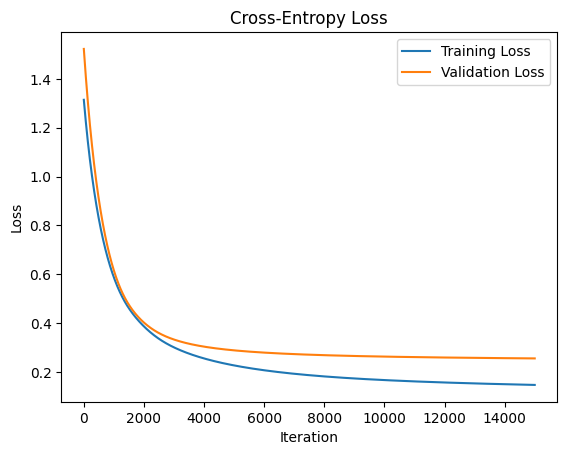

In [48]:
# train the model

model = LogisticRegression(learning_rate=0.001, n_iters=15000)
model.fit(X_train, y_train)

In [55]:
# make predictions
y_pred = model.predict(X_test)
len(y_pred)

57

In [56]:
# calculate accuracy, recall, precision, and F1 score
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score

accuracy = accuracy_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

print("Accuracy:", accuracy)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

Accuracy: 0.9473684210526315
Recall: 0.95
Precision: 0.9743589743589743
F1 Score: 0.9620253164556962


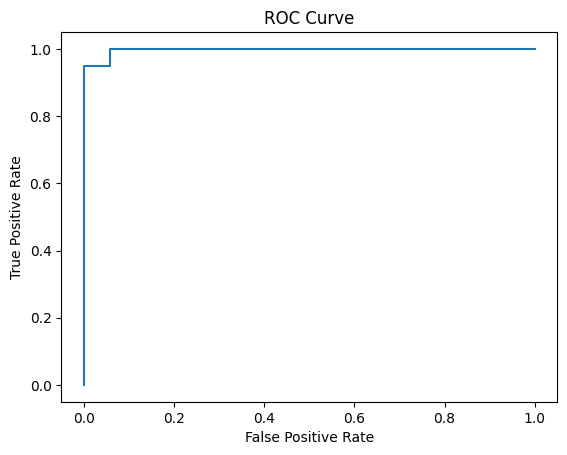

In [57]:
# AUC-ROC curve
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

y_pred_proba = model.sigmoid(np.dot(X_test, model.weights) + model.bias)
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)

plt.plot(fpr, tpr)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve")
plt.show()
